In [ ]:
# import packages
import os, gc
import zarr
import numpy as np
import pandas as pd
from tqdm import tqdm
from typing import Dict
from collections import Counter
from prettytable import PrettyTable

#level5 toolkit
from l5kit.data import PERCEPTION_LABELS
from l5kit.dataset import EgoDataset, AgentDataset
from l5kit.data import ChunkedDataset, LocalDataManager

# level5 toolkit
from l5kit.configs import load_config_data
from l5kit.geometry import transform_points
from l5kit.rasterization import build_rasterizer
from l5kit.visualization import draw_trajectory, draw_reference_trajectory, TARGET_POINTS_COLOR
from l5kit.evaluation import write_pred_csv, compute_metrics_csv, read_gt_csv, create_chopped_dataset

# visualization
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib import animation
from colorama import Fore, Back, Style

# deep learning
import torch
from torch import nn, optim
from torch.utils.data import DataLoader
from torchvision.models.resnet import resnet18, resnet50, resnet34

print((os.listdir('../input/lyft-motion-prediction-autonomous-vehicles/')))

plt.rc('animation', html='jshtml')

%matplotlib inline

['multi_mode_sample_submission.csv', 'semantic_map', 'aerial_map', 'single_mode_sample_submission.csv', 'meta.json', 'scenes']


In [ ]:
def animate_solution(images):

    def animate(i):
        im.set_data(images[i])

    fig, ax = plt.subplots()
    im = ax.imshow(images[0])

    return animation.FuncAnimation(fig, animate, frames=len(images), interval=80)

In [ ]:
import yaml

# Paste your YAML as a multiline string
yaml_config = """

model_params:
  model_architecture: "resnet50"

  history_num_frames: 10
  history_step_size: 1
  history_delta_time: 0.1

  future_num_frames: 50
  future_step_size: 1
  future_delta_time: 0.1

raster_params:
  raster_size: [224, 224]
  pixel_size: [0.5, 0.5]
  ego_center: [0.25, 0.5]
  map_type: "py_semantic"
  satellite_map_key: "aerial_map/aerial_map.png"
  semantic_map_key: "semantic_map/semantic_map.pb"
  dataset_meta_key: "meta.json"
  filter_agents_threshold: 0.5
  use_history: True

train_data_loader:
  key: "scenes/train.zarr"
  batch_size: 12
  shuffle: True
  num_workers: 16

val_data_loader:
  key: "scenes/validate.zarr"
  batch_size: 12
  shuffle: False
  num_workers: 16

sample_data_loader:
  key: "scenes/sample.zarr"
  batch_size: 12
  shuffle: False
  num_workers: 16

train_params:
  checkpoint_every_n_steps: 10000
  max_num_steps: 5
  eval_every_n_steps: 10000
"""

# Load the YAML string as a Python dictionary
cfg = yaml.safe_load(yaml_config)

# Now you can use cfg just like you would if you loaded from a file
print("Raster parameters:")
for k, v in cfg["raster_params"].items():
    print(f"{k}: {v}")


Raster parameters:
raster_size: [224, 224]
pixel_size: [0.5, 0.5]
ego_center: [0.25, 0.5]
map_type: py_semantic
satellite_map_key: aerial_map/aerial_map.png
semantic_map_key: semantic_map/semantic_map.pb
dataset_meta_key: meta.json
filter_agents_threshold: 0.5
use_history: True


In [ ]:
train = zarr.open("../input/lyft-motion-prediction-autonomous-vehicles/scenes/train.zarr")
validation = zarr.open("../input/lyft-motion-prediction-autonomous-vehicles/scenes/validate.zarr")
test = zarr.open("../input/lyft-motion-prediction-autonomous-vehicles/scenes/test.zarr/")
train.info

Name,/
Type,zarr.hierarchy.Group
Read-only,False
Store type,zarr.storage.DirectoryStore
No. members,5
No. arrays,4
No. groups,1
Arrays,"agents, frames, scenes, traffic_light_faces"
Groups,agents_mask


In [ ]:
print(f'We have {len(train.agents)} agents, {len(train.scenes)} scenes, {len(train.frames)} frames and {len(train.traffic_light_faces)} traffic light faces in train.zarr.')
print(f'We have {len(validation.agents)} agents, {len(validation.scenes)} scenes, {len(validation.frames)} frames and {len(validation.traffic_light_faces)} traffic light faces in validation.zarr.')
print(f'We have {len(test.agents)} agents, {len(test.scenes)} scenes, {len(test.frames)} frames and {len(test.traffic_light_faces)} traffic light faces in test.zarr.')


We have 320124624 agents, 16265 scenes, 4039527 frames and 38735988 traffic light faces in train.zarr.
We have 312617887 agents, 16220 scenes, 4030296 frames and 29277930 traffic light faces in validation.zarr.
We have 88594921 agents, 11314 scenes, 1131400 frames and 7854144 traffic light faces in test.zarr.


In [ ]:
os.environ["L5KIT_DATA_FOLDER"] = "../input/lyft-motion-prediction-autonomous-vehicles"


In [ ]:
dm = LocalDataManager()
dataset_path = dm.require(cfg["val_data_loader"]["key"])
zarr_dataset = ChunkedDataset(dataset_path)
zarr_dataset.open()
print(zarr_dataset)

+------------+------------+------------+---------------+-----------------+----------------------+----------------------+----------------------+---------------------+
| Num Scenes | Num Frames | Num Agents | Num TR lights | Total Time (hr) | Avg Frames per Scene | Avg Agents per Frame | Avg Scene Time (sec) | Avg Frame frequency |
+------------+------------+------------+---------------+-----------------+----------------------+----------------------+----------------------+---------------------+
|   16220    |  4030296   | 312617887  |    29277930   |      111.97     |        248.48        |        77.57         |        24.85         |        10.00        |
+------------+------------+------------+---------------+-----------------+----------------------+----------------------+----------------------+---------------------+


/kaggle/usr/lib/lyft-l5kit-unofficial-fix/l5kit/dataset/ego.py:152: RuntimeWarning: disable_traffic_light_faces not found in config, this will raise an error in the future
  return self.get_frame(scene_index, state_index)


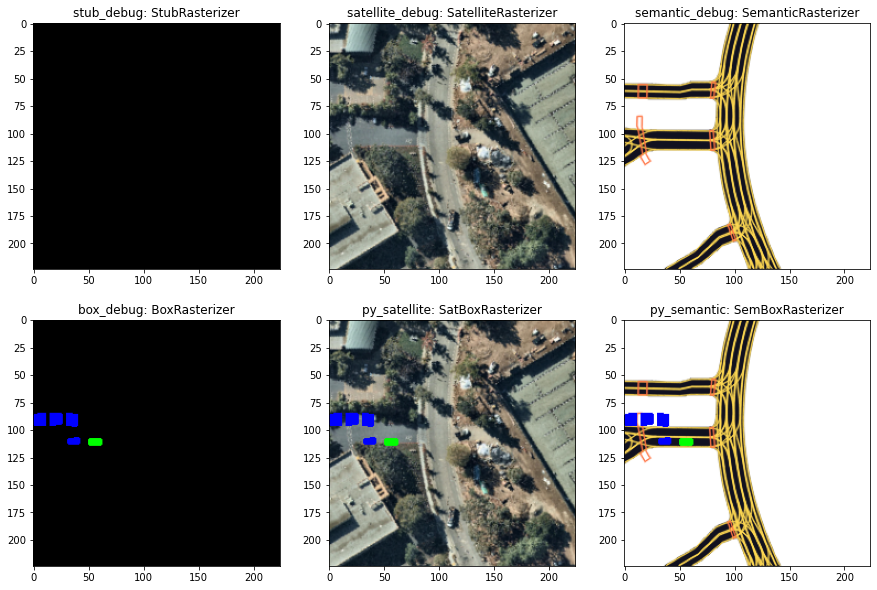

In [ ]:
sns.set_style({'axes.grid': False})

def visualize_rgb_image(dataset, index, title="", ax=None):
    """Visualizes Rasterizer's RGB image"""
    data = dataset[index]
    im = data["image"].transpose(1, 2, 0)
    im = dataset.rasterizer.to_rgb(im)

    if ax is None:
        fig, ax = plt.subplots()
    if title:
        ax.set_title(title)
    ax.imshow(im[::-1])
# Prepare all rasterizer and EgoDataset for each rasterizer
rasterizer_dict = {}
dataset_dict = {}

rasterizer_type_list = ["py_satellite", "satellite_debug", "py_semantic", "semantic_debug", "box_debug", "stub_debug"]

for i, key in enumerate(rasterizer_type_list):
    # print("key", key)
    cfg["raster_params"]["map_type"] = key
    rasterizer_dict[key] = build_rasterizer(cfg, dm)
    dataset_dict[key] = EgoDataset(cfg, zarr_dataset, rasterizer_dict[key])
fig, axes = plt.subplots(2, 3, figsize=(15, 10))
axes = axes.flatten()
for i, key in enumerate(["stub_debug", "satellite_debug", "semantic_debug", "box_debug", "py_satellite", "py_semantic"]):
    visualize_rgb_image(dataset_dict[key], index=0, title=f"{key}: {type(rasterizer_dict[key]).__name__}", ax=axes[i])
fig.show()

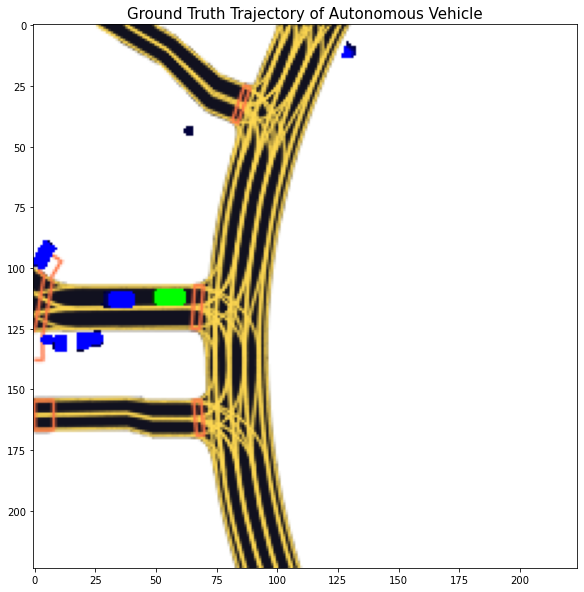

In [ ]:
# Set rasterizer type
cfg["raster_params"]["map_type"] = "py_semantic"

# Build rasterizer and EgoDataset
rast = build_rasterizer(cfg, dm)
dataset = EgoDataset(cfg, zarr_dataset, rast)

# Select a sample
data = dataset[50]

# Convert the rasterized image to RGB for plotting
im = data["image"].transpose(1, 2, 0)
im = dataset.rasterizer.to_rgb(im)

# Step 1: Convert target positions from agent to world coordinates
target_positions_world = transform_points(data["target_positions"], data["agent_from_world"])  # agent->world

# Step 2: Convert from world to raster/image coordinates
target_positions_pixels = transform_points(target_positions_world, data["raster_from_world"])  # world->image

# Plot ground truth trajectory
draw_trajectory(im, target_positions_pixels, TARGET_POINTS_COLOR, yaws=data["target_yaws"])

plt.rcParams['figure.figsize'] = 10, 10
plt.title('Ground Truth Trajectory of Autonomous Vehicle', fontsize=15)
plt.imshow(im)
plt.show()


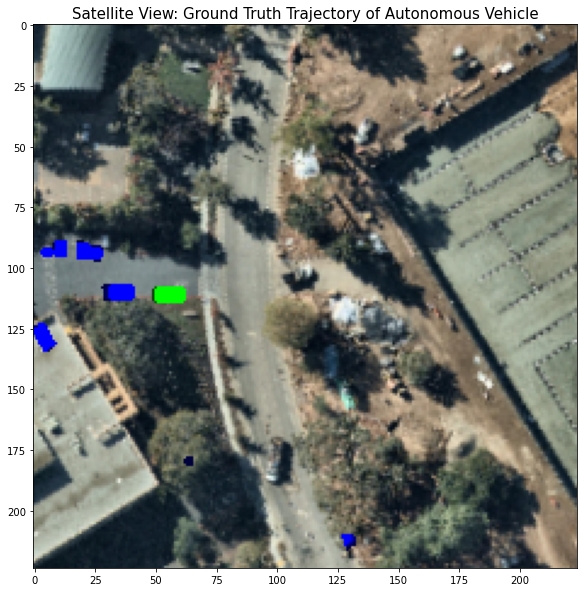

In [ ]:
cfg["raster_params"]["map_type"] = "py_satellite"
rast = build_rasterizer(cfg, dm)

# EgoDataset object
dataset = EgoDataset(cfg, zarr_dataset, rast)
data = dataset[50]

im = data["image"].transpose(1, 2, 0)
im = dataset.rasterizer.to_rgb(im)
target_positions_world = transform_points(data["target_positions"], data["agent_from_world"])
target_positions_pixels = transform_points(target_positions_world, data["raster_from_world"])
draw_trajectory(im, target_positions_pixels, TARGET_POINTS_COLOR, yaws=data["target_yaws"])

plt.rcParams['figure.figsize'] = 10, 10
plt.title('Satellite View: Ground Truth Trajectory of Autonomous Vehicle',fontsize=15)
plt.imshow(im[::-1])
plt.show()

In [ ]:
dataset

In [ ]:
gc.collect()

In [ ]:
DEBUG = True

# training cfg
training_cfg = {

    'format_version': 4,

     ## Model options
    'model_params': {
        'model_architecture': 'resnet34',
        'history_num_frames': 10,
        'history_step_size': 1,
        'history_delta_time': 0.1,
        'future_num_frames': 50,
        'future_step_size': 1,
        'future_delta_time': 0.1,
    },

    ## Input raster parameters
    'raster_params': {

        'raster_size': [224, 224], # raster's spatial resolution [meters per pixel]: the size in the real world one pixel corresponds to.
        'pixel_size': [0.5, 0.5], # From 0 to 1 per axis, [0.5,0.5] would show the ego centered in the image.
        'ego_center': [0.25, 0.5],
        'map_type': "py_semantic",

        # the keys are relative to the dataset environment variable
        'satellite_map_key': "aerial_map/aerial_map.png",
        'semantic_map_key': "semantic_map/semantic_map.pb",
        'dataset_meta_key': "meta.json",

        # e.g. 0.0 include every obstacle, 0.5 show those obstacles with >0.5 probability of being
        # one of the classes we care about (cars, bikes, peds, etc.), >=1.0 filter all other agents.
        'filter_agents_threshold': 0.5
    },

    ## Data loader options
    'train_data_loader': {
        'key': "scenes/train.zarr",
        'batch_size': 16,
        'shuffle': True,
        'num_workers': 4
    },

    ## Train params
    'train_params': {
        'checkpoint_every_n_steps': 5000,
        'max_num_steps': 1000
    }
}

# inference cfg
inference_cfg = {

    'format_version': 4,
    'model_params': {
        'history_num_frames': 10,
        'history_step_size': 1,
        'history_delta_time': 0.1,
        'future_num_frames': 50,
        'future_step_size': 1,
        'future_delta_time': 0.1
    },

    'raster_params': {
        'raster_size': [300, 300],
        'pixel_size': [0.5, 0.5],
        'ego_center': [0.25, 0.5],
        'map_type': 'py_semantic',
        'satellite_map_key': 'aerial_map/aerial_map.png',
        'semantic_map_key': 'semantic_map/semantic_map.pb',
        'dataset_meta_key': 'meta.json',
        'filter_agents_threshold': 0.5
    },

        'test_data_loader': {
        'key': 'scenes/test.zarr',
        'batch_size': 8,
        'shuffle': False,
        'num_workers': 4
    }

}

In [ ]:
# root directory
DIR_INPUT = "/kaggle/input/lyft-motion-prediction-autonomous-vehicles"

#submission
SINGLE_MODE_SUBMISSION = f"{DIR_INPUT}/single_mode_sample_submission.csv"
MULTI_MODE_SUBMISSION = f"{DIR_INPUT}/multi_mode_sample_submission.csv"

# set env variable for data
os.environ["L5KIT_DATA_FOLDER"] = DIR_INPUT
dm = LocalDataManager(None)
print(training_cfg)

{'format_version': 4, 'model_params': {'model_architecture': 'resnet34', 'history_num_frames': 10, 'history_step_size': 1, 'history_delta_time': 0.1, 'future_num_frames': 50, 'future_step_size': 1, 'future_delta_time': 0.1}, 'raster_params': {'raster_size': [224, 224], 'pixel_size': [0.5, 0.5], 'ego_center': [0.25, 0.5], 'map_type': 'py_semantic', 'satellite_map_key': 'aerial_map/aerial_map.png', 'semantic_map_key': 'semantic_map/semantic_map.pb', 'dataset_meta_key': 'meta.json', 'filter_agents_threshold': 0.5}, 'train_data_loader': {'key': 'scenes/train.zarr', 'batch_size': 16, 'shuffle': True, 'num_workers': 4}, 'train_params': {'checkpoint_every_n_steps': 5000, 'max_num_steps': 1000}}


In [ ]:
# training cfg
train_cfg = training_cfg["train_data_loader"]

# rasterizer
rasterizer = build_rasterizer(training_cfg, dm)

# dataloader
train_zarr = ChunkedDataset(dm.require(train_cfg["key"])).open()
train_dataset = AgentDataset(training_cfg, train_zarr, rasterizer)
train_dataloader = DataLoader(train_dataset, shuffle=train_cfg["shuffle"], batch_size=train_cfg["batch_size"],
                             num_workers=train_cfg["num_workers"])
print(train_dataset)

+------------+------------+------------+---------------+-----------------+----------------------+----------------------+----------------------+---------------------+
| Num Scenes | Num Frames | Num Agents | Num TR lights | Total Time (hr) | Avg Frames per Scene | Avg Agents per Frame | Avg Scene Time (sec) | Avg Frame frequency |
+------------+------------+------------+---------------+-----------------+----------------------+----------------------+----------------------+---------------------+
|   16265    |  4039527   | 320124624  |    38735988   |      112.19     |        248.36        |        79.25         |        24.83         |        10.00        |
+------------+------------+------------+---------------+-----------------+----------------------+----------------------+----------------------+---------------------+


In [ ]:
class LyftModel(nn.Module):

    def __init__(self, cfg):
        super().__init__()

        # Use resnet50
        self.backbone = resnet50(pretrained=False)

        num_history_channels = (cfg["model_params"]["history_num_frames"] + 1) * 2
        num_in_channels = 3 + num_history_channels

        # Update first conv to handle multi-channel input
        self.backbone.conv1 = nn.Conv2d(
            num_in_channels,
            self.backbone.conv1.out_channels,
            kernel_size=self.backbone.conv1.kernel_size,
            stride=self.backbone.conv1.stride,
            padding=self.backbone.conv1.padding,
            bias=False,
        )
        backbone_out_features = 2048

        num_targets = 2 * cfg["model_params"]["future_num_frames"]

        self.head = nn.Sequential(
            nn.Linear(in_features=backbone_out_features, out_features=4096),
        )

        self.logit = nn.Linear(4096, out_features=num_targets)

    def forward(self, x):
        x = self.backbone.conv1(x)
        x = self.backbone.bn1(x)
        x = self.backbone.relu(x)
        x = self.backbone.maxpool(x)

        x = self.backbone.layer1(x)
        x = self.backbone.layer2(x)
        x = self.backbone.layer3(x)
        x = self.backbone.layer4(x)

        x = self.backbone.avgpool(x)
        x = torch.flatten(x, 1)

        x = self.head(x)
        x = self.logit(x)

        return x


In [ ]:
# compiling model
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model = LyftModel(training_cfg).to(device)
optimizer = optim.Adam(model.parameters(), lr=1e-3)
criterion = nn.MSELoss(reduction="none")
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=50, gamma=0.5)


In [ ]:
# get hardware type (CPU, GPU, TPU)
device

device(type='cuda', index=0)

In [ ]:
import matplotlib.pyplot as plt

# Training loop (unchanged except shorter loss window in tqdm)
tr_it = iter(train_dataloader)
progress_bar = tqdm(range(training_cfg["train_params"]["max_num_steps"]))
losses_train = []

for itr in progress_bar:
    try:
        data = next(tr_it)
    except StopIteration:
        tr_it = iter(train_dataloader)
        data = next(tr_it)

    model.train()
    torch.set_grad_enabled(True)

    inputs = data["image"].to(device)
    target_availabilities = data["target_availabilities"].unsqueeze(-1).to(device)
    targets = data["target_positions"].to(device)

    outputs = model(inputs).reshape(targets.shape)
    loss = criterion(outputs, targets)
    loss = loss * target_availabilities
    loss = loss.mean()

    optimizer.zero_grad()
    loss.backward()
    optimizer.step()
    scheduler.step()

    losses_train.append(loss.item())

    # if (itr + 1) % training_cfg['train_params']['checkpoint_every_n_steps'] == 0:
    #     torch.save({
    #         'epoch': itr + 1,
    #         'model_state_dict': model.state_dict(),
    #         'optimizer_state_dict': optimizer.state_dict()
    #     }, f'/content/drive/My Drive/Lyft L5 Motion Prediction/resnet18_300x300_model_state_{itr}.pth')

    progress_bar.set_description(f"loss: {loss.item():.4f} avg(last 100): {np.mean(losses_train[-100:]):.4f}")

loss: 2.6557 avg(last 100): 8.5594: 100%|██████████| 1000/1000 [16:55<00:00,  1.02s/it] 


In [ ]:
model = model.to(device)
model.eval()
torch.set_grad_enabled(False)

future_coords_offsets_pd = []
gt_positions_list       = []
timestamps              = []
agent_ids               = []

for data in tqdm(test_dataloader):
    # Move inputs & ground truth to device
    inputs               = data["image"].to(device)
    targets              = data["target_positions"].to(device)

    # Forward pass
    outputs = model(inputs)
    outputs = outputs.reshape(targets.shape)

    future_coords_offsets_pd.append(outputs.cpu().numpy().copy())
    gt_positions_list.append(targets.cpu().numpy().copy())

    timestamps.append(data["timestamp"].numpy().copy())
    agent_ids.append(data["track_id"].numpy().copy())

100%|██████████| 13/13 [00:08<00:00,  1.56it/s]


In [ ]:
def compute_ADE(preds: np.ndarray, gts: np.ndarray, availabilities: np.ndarray = None) -> float:
    l1_errors = np.sum(np.abs(preds - gts), axis=-1)

    if availabilities is not None:
        l1_errors = l1_errors * availabilities
        ade_per_agent = np.sum(l1_errors, axis=1) / np.sum(availabilities, axis=1)
    else:
        ade_per_agent = np.mean(l1_errors, axis=1)

    return np.mean(ade_per_agent)

all_preds = np.concatenate(future_coords_offsets_pd, axis=0)
all_gts   = np.concatenate(gt_positions_list, axis=0)

ade_score = compute_ADE(all_preds, all_gts)
print(f"Average Displacement Error (ADE): {ade_score:.4f} meters")

Average Displacement Error (ADE): 41.1638 meters


In [ ]:
plt.figure(figsize=(10, 4))
plt.plot(losses_train, label="Train Loss")
plt.xlabel("Iteration")
plt.ylabel("Loss")
plt.title("Training Loss Curve - ResNet50")
plt.grid(True)
plt.legend()
plt.tight_layout()

plt.savefig("/kaggle/working/train_loss_plot.png", dpi=300, bbox_inches="tight")
plt.close()  # optional, helps avoid blank image in loops

In [ ]:
# compiling model
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model = LyftModel(training_cfg).to(device)
optimizer = optim.Adam(model.parameters(), lr=1e-3)
criterion = nn.MSELoss(reduction="none")
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=50, gamma=0.5)


In [ ]:
import matplotlib.pyplot as plt

# Init
tr_it = iter(train_dataloader)
progress_bar = tqdm(range(training_cfg["train_params"]["max_num_steps"]))

# Store all losses for plotting
losses_total = []
losses_mse = []
losses_vel = []
losses_acc = []
losses_jerk = []

# PINN loss weights
alpha, beta = 0.5, 0.5

for _ in progress_bar:
    try:
        data = next(tr_it)
    except StopIteration:
        tr_it = iter(train_dataloader)
        data = next(tr_it)

    model.train()
    torch.set_grad_enabled(True)

    inputs = data["image"].to(device)
    target_availabilities = data["target_availabilities"].unsqueeze(-1).to(device)
    targets = data["target_positions"].to(device)

    outputs = model(inputs).reshape(targets.shape)

    # MSE Loss
    mse_loss = ((outputs - targets) ** 2) * target_availabilities
    mse_loss = mse_loss.mean()

    # Velocity Loss
    vel_pred = outputs[:, 1:, :] - outputs[:, :-1, :]
    vel_gt   = targets[:, 1:, :] - targets[:, :-1, :]
    vel_mask = target_availabilities[:, 1:]
    velocity_loss = ((vel_pred - vel_gt) ** 2) * vel_mask
    velocity_loss = velocity_loss.mean()

    # Acceleration Loss
    acc_pred = vel_pred[:, 1:, :] - vel_pred[:, :-1, :]
    acc_gt   = vel_gt[:, 1:, :] - vel_gt[:, :-1, :]
    acc_mask = target_availabilities[:, 2:]
    acceleration_loss = ((acc_pred - acc_gt) ** 2) * acc_mask
    acceleration_loss = acceleration_loss.mean()


    # Total Loss
    total_loss = mse_loss + alpha * velocity_loss + beta * acceleration_loss

    optimizer.zero_grad()
    total_loss.backward()
    optimizer.step()
    scheduler.step()

    # Store loss values for plotting
    losses_total.append(total_loss.item())
    losses_mse.append(mse_loss.item())
    losses_vel.append(velocity_loss.item())
    losses_acc.append(acceleration_loss.item())
    # losses_jerk.append(jerk_loss.item())

    progress_bar.set_description(
        f"Loss: {total_loss.item():.4f} | MSE: {mse_loss.item():.4f}"
    )

/kaggle/usr/lib/lyft-l5kit-unofficial-fix/l5kit/dataset/agent.py:115: RuntimeWarning: disable_traffic_light_faces not found in config, this will raise an error in the future
  return self.get_frame(scene_index, state_index, track_id=track_id)
/kaggle/usr/lib/lyft-l5kit-unofficial-fix/l5kit/dataset/agent.py:115: RuntimeWarning: disable_traffic_light_faces not found in config, this will raise an error in the future
  return self.get_frame(scene_index, state_index, track_id=track_id)
/kaggle/usr/lib/lyft-l5kit-unofficial-fix/l5kit/dataset/agent.py:115: RuntimeWarning: disable_traffic_light_faces not found in config, this will raise an error in the future
  return self.get_frame(scene_index, state_index, track_id=track_id)
/kaggle/usr/lib/lyft-l5kit-unofficial-fix/l5kit/dataset/agent.py:115: RuntimeWarning: disable_traffic_light_faces not found in config, this will raise an error in the future
  return self.get_frame(scene_index, state_index, track_id=track_id)
Loss: 11.2849 | MSE: 11.2659

In [ ]:
plt.figure(figsize=(12, 6))
plt.plot(losses_total, label='Total Loss', linewidth=2)
plt.plot(losses_mse, label='MSE Loss')
plt.plot(losses_vel, label='Velocity Loss')
plt.plot(losses_acc, label='Acceleration Loss')
# plt.plot(losses_jerk, label='Jerk Loss')

plt.xlabel("Training Step")
plt.ylabel("Loss")
plt.title("Training Loss Components (PINN Loss) - ResNet50")
plt.grid(True)
plt.legend()
plt.tight_layout()
# plt.show()

plt.savefig("/kaggle/working/training_loss_with_pinn.png", dpi=300)

plt.close()

In [ ]:
# save full trained model
torch.save(model.state_dict(), f'/kaggle/working/model_state_last.pth')

In [ ]:
from torch.utils.data import Subset
# test configuration
test_cfg = inference_cfg["test_data_loader"]

# Rasterizer
rasterizer = build_rasterizer(inference_cfg, dm)

# Test dataset/dataloader
test_zarr = ChunkedDataset(dm.require(test_cfg["key"])).open()
test_mask = np.load(f"{DIR_INPUT}/scenes/mask.npz")["arr_0"]
test_dataset = AgentDataset(inference_cfg, test_zarr, rasterizer, agents_mask=test_mask)

test_dataset_subset = Subset(test_dataset, list(range(100)))
print(len(test_dataset_subset))
test_dataloader = DataLoader(test_dataset_subset,
                             shuffle=test_cfg["shuffle"],
                             batch_size=test_cfg["batch_size"],
                             num_workers=test_cfg["num_workers"])

print(test_dataloader)

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: you're running with a custom agents_mask
  # This is added back by InteractiveShellApp.init_path()


100


In [ ]:
model.eval()
torch.set_grad_enabled(False)

# store information for evaluation
future_coords_offsets_pd = []
timestamps = []

agent_ids = []
progress_bar = tqdm(test_dataloader)
for data in progress_bar:

    inputs = data["image"].to(device)
    target_availabilities = data["target_availabilities"].unsqueeze(-1).to(device)
    targets = data["target_positions"].to(device)

    outputs = model(inputs).reshape(targets.shape)

    future_coords_offsets_pd.append(outputs.cpu().numpy().copy())
    timestamps.append(data["timestamp"].numpy().copy())
    agent_ids.append(data["track_id"].numpy().copy())

  0%|          | 0/13 [00:00<?, ?it/s]/kaggle/usr/lib/lyft-l5kit-unofficial-fix/l5kit/dataset/agent.py:115: RuntimeWarning: disable_traffic_light_faces not found in config, this will raise an error in the future
  return self.get_frame(scene_index, state_index, track_id=track_id)
/kaggle/usr/lib/lyft-l5kit-unofficial-fix/l5kit/dataset/agent.py:115: RuntimeWarning: disable_traffic_light_faces not found in config, this will raise an error in the future
  return self.get_frame(scene_index, state_index, track_id=track_id)
/kaggle/usr/lib/lyft-l5kit-unofficial-fix/l5kit/dataset/agent.py:115: RuntimeWarning: disable_traffic_light_faces not found in config, this will raise an error in the future
  return self.get_frame(scene_index, state_index, track_id=track_id)
/kaggle/usr/lib/lyft-l5kit-unofficial-fix/l5kit/dataset/agent.py:115: RuntimeWarning: disable_traffic_light_faces not found in config, this will raise an error in the future
  return self.get_frame(scene_index, state_index, track_id=

In [ ]:

batch_index = 0
agent_index = 2

predicted_offsets = future_coords_offsets_pd[batch_index][agent_index]  # [T, 2]
timestamp = timestamps[batch_index][agent_index]
track_id = agent_ids[batch_index][agent_index]

for i in range(len(test_dataset)):
    data_vis = test_dataset[i]
    if data_vis["timestamp"] == timestamp and data_vis["track_id"] == track_id:
        break

im = data_vis["image"].transpose(1, 2, 0)
im = test_dataset.rasterizer.to_rgb(im.copy())


/kaggle/usr/lib/lyft-l5kit-unofficial-fix/l5kit/dataset/agent.py:115: RuntimeWarning: disable_traffic_light_faces not found in config, this will raise an error in the future
  return self.get_frame(scene_index, state_index, track_id=track_id)


In [ ]:
outputs = model(inputs).reshape(targets.shape)


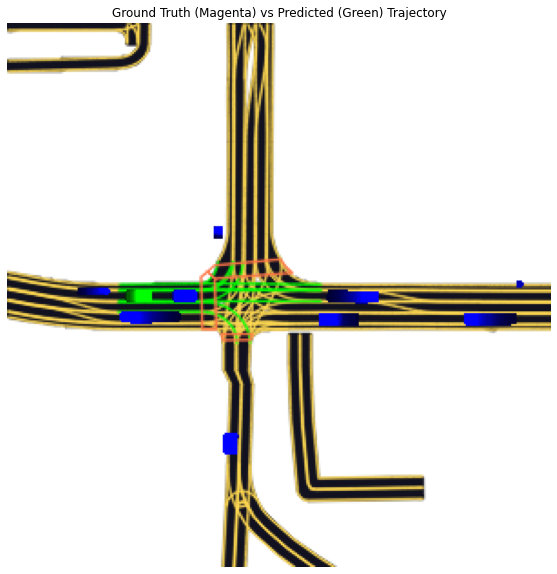

In [ ]:

# gt_world = transform_points(data_vis["target_positions"], data_vis["agent_from_world"])
# gt_pixels = transform_points(gt_world, data_vis["raster_from_world"])
# draw_trajectory(im, gt_pixels, rgb_color=TARGET_POINTS_COLOR, yaws=data_vis["target_yaws"])

pred_world = transform_points(predicted_offsets, data_vis["agent_from_world"])
pred_pixels = transform_points(pred_world, data_vis["raster_from_world"])
draw_trajectory(im, pred_pixels, rgb_color=TARGET_POINTS_COLOR)

# ---------------------------------------------
# Plot
plt.figure(figsize=(10, 10))
plt.title("Ground Truth (Magenta) vs Predicted (Green) Trajectory")
plt.imshow(im)
plt.axis("off")
plt.show()

In [ ]:
model = model.to(device)
model.eval()
torch.set_grad_enabled(False)

future_coords_offsets_pd = []  # will collect model outputs (B, T, 2)
gt_positions_list       = []  # will collect ground‐truth future positions (B, T, 2)
timestamps              = []  # if you need timestamps later
agent_ids               = []  # if you need agent IDs later

for data in tqdm(test_dataloader):
    # Move inputs & ground truth to device
    inputs               = data["image"].to(device)                     # (B, C, H, W) or similar
    targets              = data["target_positions"].to(device)          # (B, T, 2)
    # (Optional) target_availabilities is often unused for ADE directly
    # target_availabilities = data["target_availabilities"].unsqueeze(-1).to(device)

    # Forward pass
    outputs = model(inputs)                 # raw model output, shape depends on your head
    outputs = outputs.reshape(targets.shape)  # force shape (B, T, 2)

    # Store predictions and ground‐truth as NumPy
    future_coords_offsets_pd.append(outputs.cpu().numpy().copy())  # (B, T, 2)
    gt_positions_list.append(targets.cpu().numpy().copy())         # (B, T, 2)

    # (Optional) if you need timestamps/agent_ids for debugging or analysis:
    timestamps.append(data["timestamp"].numpy().copy())  # shape (B,)
    agent_ids.append(data["track_id"].numpy().copy())    # shape (B,)

100%|██████████| 13/13 [00:08<00:00,  1.52it/s]


In [ ]:
def compute_ADE(preds: np.ndarray, gts: np.ndarray, availabilities: np.ndarray = None) -> float:
    l1_errors = np.sum(np.abs(preds - gts), axis=-1)  # shape: (N, T)

    if availabilities is not None:
        l1_errors = l1_errors * availabilities  # mask invalid steps
        ade_per_agent = np.sum(l1_errors, axis=1) / np.sum(availabilities, axis=1)
    else:
        ade_per_agent = np.mean(l1_errors, axis=1)

    return np.mean(ade_per_agent)

all_preds = np.concatenate(future_coords_offsets_pd, axis=0)  # → (N_agents, T, 2)
all_gts   = np.concatenate(gt_positions_list, axis=0)         # → (N_agents, T, 2)

# -----------------------------------
# 4) Compute ADE
# -----------------------------------
ade_score = compute_ADE(all_preds, all_gts)
print(f"Average Displacement Error (ADE): {ade_score:.4f} meters")

Average Displacement Error (ADE): 4.4189 meters


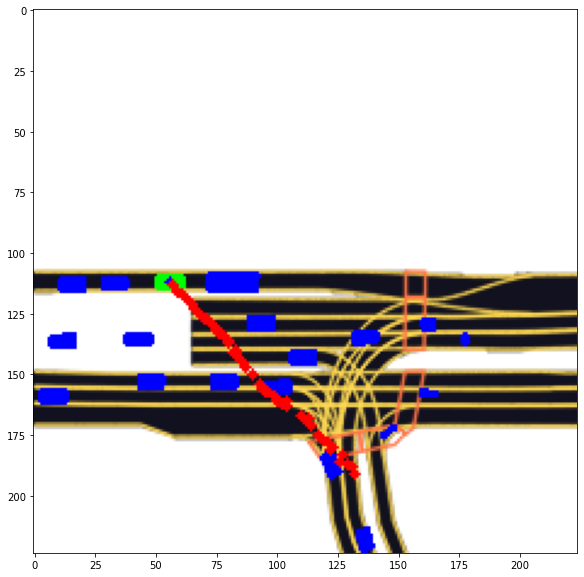

In [ ]:
from IPython.display import display, HTML
import PIL
import torch
import numpy as np

# Rasterizer and Dataset
cfg["raster_params"]["map_type"] = "py_semantic"
rasterizer = build_rasterizer(cfg, dm)
dataset = EgoDataset(cfg, zarr_dataset, rasterizer)

scene_idx = 34
indexes = dataset.get_scene_indices(scene_idx)
images = []

model.eval()
torch.set_grad_enabled(False)

for idx in indexes:
    data = dataset[idx]
    # 1. Prepare input (reshape to batch)
    input_image = torch.tensor(data["image"]).unsqueeze(0).to(device)  # (1, C, H, W)

    # 2. Model forward pass
    with torch.no_grad():
        output = model(input_image)         # (1, T*2)
        output = output.view(-1, 2).cpu().numpy()  # (T, 2)

    # 3. Convert model output from relative to world coordinates
    pred_world = output + data["centroid"][:2]  # Add offset
    gt_world = data["target_positions"] + data["centroid"][:2]

    # 4. Convert to image (pixel) coordinates
    pred_pixels = transform_points(pred_world, data["world_to_image"])
    gt_pixels = transform_points(gt_world, data["world_to_image"])
    # 5. Get RGB image for visualization
    im = data["image"].transpose(1, 2, 0)
    im = dataset.rasterizer.to_rgb(im)
    assert im.dtype == np.uint8 and im.shape[2] == 3, f"Unexpected image format: {im.shape}, {im.dtype}"

    # 6. Draw GT trajectory (blue)
    draw_trajectory(im, gt_pixels, yaws=None, rgb_color=(0, 0, 255), radius=2)

    # 7. Draw predicted trajectory (red)
    draw_trajectory(im, pred_pixels, yaws=None, rgb_color=(255, 0, 0), radius=2)

    # 8. Append to animation sequence
    images.append(PIL.Image.fromarray(im))

# Final Animation
anim = animate_solution(images)
display(HTML(anim.to_jshtml()))
